In [1]:
using CSV, DataFrames

In [53]:
df = CSV.read("Map_of_Registered_Business_Locations.csv")

,Location Id,Business Account Number,Ownership Name,DBA Name,Street Address,City,State,Source Zipcode,Business Start Date,Business End Date,Location Start Date,Location End Date,Mail Address,Mail City,Mail Zipcode,Mail State,NAICS Code,NAICS Code Description,Parking Tax,Transient Occupancy Tax,LIC Code,LIC Code Description,Supervisor District,Neighborhoods - Analysis Boundaries,Business Corridor,Business Location
,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Bool⍰,Bool⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰
1,0474285-05-001,474285,Pressed Juicery Inc,Pressed Juicery,550 Gene Friend Way,San Francisco,CA,94158,12/01/2012,missing,06/28/2013,06/28/2013,1550 17th Street,Santa Monica,90404,CA,4400-4599,Retail Trade,false,false,missing,missing,6,Mission Bay,missing,"550 GENE FRIEND WAY\nSAN FRANCISCO, CA 94158\n(37.768885, -122.390196)"
2,0474285-06-001,474285,Pressed Juicery Inc,Pressed Juicery,865 Market St #9001,San+francisco,CA,94103,12/01/2012,missing,11/12/2013,11/03/2015,1550 17th Street,Santa Monica,90404,CA,4400-4599,Retail Trade,false,false,missing,missing,missing,missing,missing,"865 MARKET ST\nSAN FRANCISCO, CA 94103\n(37.784904, -122.406929)"
3,1045798-12-151,1021444,Benhammou Ahmida,Zaalouk Market & Deli Grocery,1209 Sutter St,San Francisco,CA,94109,12/01/2015,missing,12/01/2015,missing,1209-1211 Sutter St,San Francisco,94109,CA,4400-4599,Retail Trade,false,false,missing,missing,3,Nob Hill,missing,"1209 SUTTER ST\nSAN FRANCISCO, CA 94109\n(37.78774, -122.420251)"
4,1170655-12-171,1080758,San Francisco Security Services Llc,San Francisco Security Services Llc,588 Sutter St,San Francisco,CA,94102,12/01/2017,missing,12/12/2017,missing,588 Sutter St,San Francisco,94102,CA,missing,missing,false,false,missing,missing,missing,missing,missing,missing
5,1172862-12-171,1081156,Teresa. Spalding,Teresa Spalding,195 Bonview St,San Francisco,CA,94110,01/01/2017,missing,01/01/2017,missing,195 Bonview St,San Francisco,94110,CA,5300-5399,Real Estate and Rental and Leasing Services,false,true,missing,missing,9,Bernal Heights,missing,missing
6,1172877-12-171,1081158,Three R Properties,Three R Properties,251 Diamond Street St Fl,San Francisco,CA,94114,12/27/2017,missing,12/27/2017,missing,251 Diamond Street St Fl,San Francisco,94114,CA,7210-7219,Accommodations,false,true,missing,missing,8,Castro/Upper Market,missing,missing
7,1172879-12-171,1081159,"Rhi-Mosser 275 Turk, Lp","Rhi-Mosser 275 Turk, Lp",275 Turk St,San Francisco,CA,94102,11/28/2017,missing,11/28/2017,missing,220 Montgomery St 2000 Ste,San Francisco,94104,CA,5300-5399,Real Estate and Rental and Leasing Services,false,false,missing,missing,missing,missing,missing,missing
8,1173595-12-171,1081185,Weibin Wu,Weibin Wu,3745 Lawton St,San Francisco,CA,94122,12/27/2017,missing,12/27/2017,missing,3745 Lawton St,San Francisco,94122,CA,4800-4999,Transportation and Warehousing,false,false,missing,missing,4,Sunset/Parkside,missing,missing
9,1173614-12-171,1081187,Ockchain Inc,Ockchain Inc,20026 San Miguel Ave,Castro+valley,CA,94546,07/07/2017,missing,07/07/2017,missing,20026 San Miguel Ave,Castro Valley,94546,CA,5100-5199,Information,false,false,missing,missing,missing,missing,missing,missing


In [9]:
describe(df)

,variable,mean,min,median,max,nunique,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Union…,Int64,DataType
1,Location Id,,0000024-02-999,,1176301-01-181,222871,0,String
2,Business Account Number,6.23106e5,24,468758.0,1082422,,0,Int64
3,Ownership Name,,#10 Sports Llc,,Zzr Enterprises,164934,0,String
4,DBA Name,,#1 Babes,,[415] Desserts,190345,0,String
5,Street Address,,#10,,Zero,156657,4,String
6,City,,0,,Yuma,2373,266,String
7,State,,AB,,nv,61,678,String
8,Source Zipcode,92957.8,0,94114.0,99999,,103,Int64
9,Business Start Date,,01/01/1941,,12/31/2017,11597,0,String


In [11]:
size(df, 1)

222871

In [54]:
df[df[Symbol("Parking Tax")] .== true, :][1:10, [Symbol("DBA Name"), Symbol("Parking Tax")]]

,DBA Name,Parking Tax
,String⍰,Bool⍰
1,Test 12/28/2017 Location 1 / Parking,true
2,Douglas Parking,true
3,Douglas Parking,true
4,Douglas Parking,true
5,Volume Parking Services,true
6,Douglas Parking,true
7,Douglas Parking,true
8,Hyde Park Management Llc,true
9,Chestnut Street Lot,true


In [20]:
using Pkg
pkg"add Query"

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
Fetching: [========================================>]  100.0 %.0 % Resolving package versions...
  Updating `~/.julia/environments/v1.0/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.0/Manifest.toml`
 [no changes]


In [5]:
using Query

In [39]:
@from i in df begin
	@where i[Symbol("Parking Tax")] == true
	@select i
	@collect DataFrame
end

,Location Id,Business Account Number,Ownership Name,DBA Name,Street Address,City,State,Source Zipcode,Business Start Date,Business End Date,Location Start Date,Location End Date,Mail Address,Mail City,Mail Zipcode,Mail State,NAICS Code,NAICS Code Description,Parking Tax,Transient Occupancy Tax,LIC Code,LIC Code Description,Supervisor District,Neighborhoods - Analysis Boundaries,Business Corridor,Business Location
,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Bool⍰,Bool⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰
1,1173734-12-171,1081206,Test 12/28/2017,Test 12/28/2017 Location 1 / Parking,1155 Market St,San Francisco,CA,94111,12/28/2017,missing,12/28/2017,missing,1155 Market St,San Francisco,94111,CA,8100-8139,Certain Services,true,false,missing,missing,missing,missing,missing,missing
2,0331622-05-001,331622,Douglas Parking Llc,Douglas Parking,550 Kearny St,San Francisco,CA,94111,01/01/2000,missing,07/01/2011,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,3,Financial District/South Beach,missing,missing
3,0331622-07-001,331622,Douglas Parking Llc,Douglas Parking,819 Van Ness Ave,San Francisco,CA,94109,01/01/2000,missing,08/01/2013,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,5,Western Addition,missing,missing
4,1003077-07-141,331622,Douglas Parking Llc,Douglas Parking,1 Daniel Burnham Ct,San Francisco,CA,94109,01/01/2000,missing,04/21/2014,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,missing,missing,missing,missing
5,1059531-03-161,1009459,Volume Parking Services Inc,Volume Parking Services,36 Morris St,San Francisco,CA,94107,02/10/2015,missing,03/01/2016,missing,489 Clementina St 2nd Fl.,San Francisco,94103,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,6,South of Market,missing,missing
6,1099910-08-161,331622,Douglas Parking Llc,Douglas Parking,401 Main St,San Francisco,CA,94105,01/01/2000,missing,07/01/2016,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,missing,missing,missing,missing
7,1138241-02-171,331622,Douglas Parking Llc,Douglas Parking,275 Battery St,San Francisco,CA,94111,01/01/2000,missing,02/01/2017,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,missing,missing,missing,missing
8,1173943-12-171,433156,Hyde Park Management Llc,Hyde Park Management Llc,1636 Powell St,San Francisco,CA,94133,10/20/2008,missing,12/29/2017,missing,560 Geary St,San Francisco,94102,CA,missing,missing,true,false,missing,missing,missing,missing,missing,missing
9,1003009-07-141,329140,Imperial Parking (Us) Llc,Chestnut Street Lot,2055 Chestnut St,San Francisco,CA,94123,08/18/1999,missing,08/01/2014,missing,1740 Cesar Chavez St 2w Unit,San Francisco,94124,CA,4400-4599,Retail Trade,true,false,missing,missing,2,Marina,missing,"2055 CHESTNUT ST\nSAN FRANCISCO, CA 94123\n(37.800721, -122.436985)"


In [51]:
rename!(df, [n => replace(string(n), " "=>"_") |> Symbol for n in names(df)])

,Location_Id,Business_Account_Number,Ownership_Name,DBA_Name,Street_Address,City,State,Source_Zipcode,Business_Start_Date,Business_End_Date,Location_Start_Date,Location_End_Date,Mail_Address,Mail_City,Mail_Zipcode,Mail_State,NAICS_Code,NAICS_Code_Description,Parking_Tax,Transient_Occupancy_Tax,LIC_Code,LIC_Code_Description,Supervisor_District,Neighborhoods_-_Analysis_Boundaries,Business_Corridor,Business_Location
,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Bool⍰,Bool⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰
1,0474285-05-001,474285,Pressed Juicery Inc,Pressed Juicery,550 Gene Friend Way,San Francisco,CA,94158,12/01/2012,missing,06/28/2013,06/28/2013,1550 17th Street,Santa Monica,90404,CA,4400-4599,Retail Trade,false,false,missing,missing,6,Mission Bay,missing,"550 GENE FRIEND WAY\nSAN FRANCISCO, CA 94158\n(37.768885, -122.390196)"
2,0474285-06-001,474285,Pressed Juicery Inc,Pressed Juicery,865 Market St #9001,San+francisco,CA,94103,12/01/2012,missing,11/12/2013,11/03/2015,1550 17th Street,Santa Monica,90404,CA,4400-4599,Retail Trade,false,false,missing,missing,missing,missing,missing,"865 MARKET ST\nSAN FRANCISCO, CA 94103\n(37.784904, -122.406929)"
3,1045798-12-151,1021444,Benhammou Ahmida,Zaalouk Market & Deli Grocery,1209 Sutter St,San Francisco,CA,94109,12/01/2015,missing,12/01/2015,missing,1209-1211 Sutter St,San Francisco,94109,CA,4400-4599,Retail Trade,false,false,missing,missing,3,Nob Hill,missing,"1209 SUTTER ST\nSAN FRANCISCO, CA 94109\n(37.78774, -122.420251)"
4,1170655-12-171,1080758,San Francisco Security Services Llc,San Francisco Security Services Llc,588 Sutter St,San Francisco,CA,94102,12/01/2017,missing,12/12/2017,missing,588 Sutter St,San Francisco,94102,CA,missing,missing,false,false,missing,missing,missing,missing,missing,missing
5,1172862-12-171,1081156,Teresa. Spalding,Teresa Spalding,195 Bonview St,San Francisco,CA,94110,01/01/2017,missing,01/01/2017,missing,195 Bonview St,San Francisco,94110,CA,5300-5399,Real Estate and Rental and Leasing Services,false,true,missing,missing,9,Bernal Heights,missing,missing
6,1172877-12-171,1081158,Three R Properties,Three R Properties,251 Diamond Street St Fl,San Francisco,CA,94114,12/27/2017,missing,12/27/2017,missing,251 Diamond Street St Fl,San Francisco,94114,CA,7210-7219,Accommodations,false,true,missing,missing,8,Castro/Upper Market,missing,missing
7,1172879-12-171,1081159,"Rhi-Mosser 275 Turk, Lp","Rhi-Mosser 275 Turk, Lp",275 Turk St,San Francisco,CA,94102,11/28/2017,missing,11/28/2017,missing,220 Montgomery St 2000 Ste,San Francisco,94104,CA,5300-5399,Real Estate and Rental and Leasing Services,false,false,missing,missing,missing,missing,missing,missing
8,1173595-12-171,1081185,Weibin Wu,Weibin Wu,3745 Lawton St,San Francisco,CA,94122,12/27/2017,missing,12/27/2017,missing,3745 Lawton St,San Francisco,94122,CA,4800-4999,Transportation and Warehousing,false,false,missing,missing,4,Sunset/Parkside,missing,missing
9,1173614-12-171,1081187,Ockchain Inc,Ockchain Inc,20026 San Miguel Ave,Castro+valley,CA,94546,07/07/2017,missing,07/07/2017,missing,20026 San Miguel Ave,Castro Valley,94546,CA,5100-5199,Information,false,false,missing,missing,missing,missing,missing,missing


In [37]:
@from i in df begin
	@where i.Parking_Tax == true
	@select i
	@collect DataFrame
end

,Location_Id,Business_Account_Number,Ownership_Name,DBA_Name,Street_Address,City,State,Source_Zipcode,Business_Start_Date,Business_End_Date,Location_Start_Date,Location_End_Date,Mail_Address,Mail_City,Mail_Zipcode,Mail_State,NAICS_Code,NAICS_Code_Description,Parking_Tax,Transient_Occupancy_Tax,LIC_Code,LIC_Code_Description,Supervisor_District,Neighborhoods_-_Analysis_Boundaries,Business_Corridor,Business_Location
,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,String⍰,Bool⍰,Bool⍰,String⍰,String⍰,Int64⍰,String⍰,String⍰,String⍰
1,1173734-12-171,1081206,Test 12/28/2017,Test 12/28/2017 Location 1 / Parking,1155 Market St,San Francisco,CA,94111,12/28/2017,missing,12/28/2017,missing,1155 Market St,San Francisco,94111,CA,8100-8139,Certain Services,true,false,missing,missing,missing,missing,missing,missing
2,0331622-05-001,331622,Douglas Parking Llc,Douglas Parking,550 Kearny St,San Francisco,CA,94111,01/01/2000,missing,07/01/2011,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,3,Financial District/South Beach,missing,missing
3,0331622-07-001,331622,Douglas Parking Llc,Douglas Parking,819 Van Ness Ave,San Francisco,CA,94109,01/01/2000,missing,08/01/2013,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,5,Western Addition,missing,missing
4,1003077-07-141,331622,Douglas Parking Llc,Douglas Parking,1 Daniel Burnham Ct,San Francisco,CA,94109,01/01/2000,missing,04/21/2014,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,missing,missing,missing,missing
5,1059531-03-161,1009459,Volume Parking Services Inc,Volume Parking Services,36 Morris St,San Francisco,CA,94107,02/10/2015,missing,03/01/2016,missing,489 Clementina St 2nd Fl.,San Francisco,94103,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,6,South of Market,missing,missing
6,1099910-08-161,331622,Douglas Parking Llc,Douglas Parking,401 Main St,San Francisco,CA,94105,01/01/2000,missing,07/01/2016,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,missing,missing,missing,missing
7,1138241-02-171,331622,Douglas Parking Llc,Douglas Parking,275 Battery St,San Francisco,CA,94111,01/01/2000,missing,02/01/2017,missing,1330 Broadway 630 Ste,Oakland,94612,CA,4800-4999,Transportation and Warehousing,true,false,missing,missing,missing,missing,missing,missing
8,1173943-12-171,433156,Hyde Park Management Llc,Hyde Park Management Llc,1636 Powell St,San Francisco,CA,94133,10/20/2008,missing,12/29/2017,missing,560 Geary St,San Francisco,94102,CA,missing,missing,true,false,missing,missing,missing,missing,missing,missing
9,1003009-07-141,329140,Imperial Parking (Us) Llc,Chestnut Street Lot,2055 Chestnut St,San Francisco,CA,94123,08/18/1999,missing,08/01/2014,missing,1740 Cesar Chavez St 2w Unit,San Francisco,94124,CA,4400-4599,Retail Trade,true,false,missing,missing,2,Marina,missing,"2055 CHESTNUT ST\nSAN FRANCISCO, CA 94123\n(37.800721, -122.436985)"


In [42]:
assign = :(x = 2)

:(x = 2)

In [43]:
eval(assign)

2

In [44]:
x

2

In [45]:
fieldnames(typeof(assign))

(:head, :args)

In [46]:
dump(assign)

Expr
  head: Symbol =
  args: Array{Any}((2,))
    1: Symbol x
    2: Int64 2


In [47]:
assign.args[2] = 3

3

In [48]:
eval(assign)

3

In [49]:
x

3

In [50]:
assign4 = Expr(:(=), :x, 4)

:(x = 4)

In [51]:
eval(assign4)

4

In [52]:
x

4

In [54]:
quote
	y = 42
	x = 10
end

quote
    #= In[54]:2 =#
    y = 42
    #= In[54]:3 =#
    x = 10
end

In [55]:
eval(ans)

10

In [56]:
y

42

In [57]:
x

10

In [58]:
name = "Dan"

"Dan"

In [59]:
greet = :("Hello " * $name)

:("Hello " * "Dan")

In [60]:
eval(greet)

"Hello Dan"

In [1]:
macro greet(name)
    :("Hello " * $name)
end

@greet (macro with 1 method)

In [2]:
@greet("Adrian")

"Hello Adrian"

In [4]:
@greet "Julia"

"Hello Julia"

In [5]:
macro twostep(arg)
	println("I execute at parse time. The argument is: ", arg)
	return :(println("I execute at runtime. The argument is: ", $arg))
end

@twostep (macro with 1 method)

In [11]:
ex = macroexpand(@__MODULE__, :(@twostep :(1, 2, 3)));

I execute at parse time. The argument is: $(Expr(:quote, :((1, 2, 3))))


In [12]:
eval(ex)

I execute at runtime. The argument is: (1, 2, 3)


In [15]:
shopping_list = DataFrame(produce=["Apples", "Milk", "Bread"], qty=[5, 2, 1])

,produce,qty
,String,Int64
1,Apples,5
2,Milk,2
3,Bread,1


In [18]:
@from p in shopping_list begin
    @select p
end

produce,qty
"""Apples""",5
"""Milk""",2
"""Bread""",1


In [19]:
@from p in shopping_list begin
    @select p.produce
end

3-element query result
 "Apples"
 "Milk"
 "Bread"

In [20]:
@from p in shopping_list begin
	@select p.produce
end

3-element query result
 "Apples"
 "Milk"
 "Bread"

In [21]:
@from p in shopping_list begin
	@select uppercase(p.produce), 2p.qty
end

3-element query result
 ("APPLES", 10)
 ("MILK", 4)
 ("BREAD", 2)

In [22]:
@from p in shopping_list begin
    @select { produce = uppercase(p.produce), qty = 2p.qty }
end

produce,qty
"""APPLES""",10
"""MILK""",4
"""BREAD""",2


In [23]:
@from p in shopping_list begin
    @select { PRODUCE = uppercase(p.produce), double_qty = 2p.qty }
    @collect
end

3-element Array{NamedTuple{(:PRODUCE, :double_qty),Tuple{String,Int64}},1}:
 (PRODUCE = "APPLES", double_qty = 10)
 (PRODUCE = "MILK", double_qty = 4)   
 (PRODUCE = "BREAD", double_qty = 2)  

In [24]:
@from p in shopping_list begin
    @select {PRODUCE = uppercase(p.produce), double_qty = 2p.qty}
    @collect DataFrame
end

,PRODUCE,double_qty
,String,Int64
1,APPLES,10
2,MILK,4
3,BREAD,2


In [25]:
@from p in shopping_list begin
    @where p.qty < 2
    @select p
    @collect DataFrame
end

,produce,qty
,String,Int64
1,Bread,1


In [26]:
@from p in shopping_list begin
    @let weekly_qty = 7p.qty
    @where weekly_qty > 10
    @select { p.produce, week_qty=weekly_qty }
    @collect DataFrame
end

,produce,week_qty
,String,Int64
1,Apples,35
2,Milk,14


In [27]:
products_info = DataFrame(produce = ["Apples", "Milk", "Bread"], price = [2.20, 0.45, 0.79], allergenic = [false, true, true])

,produce,price,allergenic
,String,Float64,Bool
1,Apples,2.2,false
2,Milk,0.45,true
3,Bread,0.79,true


In [28]:
shopping_info = @from p in shopping_list begin
	@join pinfo in products_info on p.produce equals pinfo.produce
	@select { p.produce, p.qty, pinfo.price, pinfo.allergenic }
	@collect DataFrame
end

,produce,qty,price,allergenic
,String,Int64,Float64,Bool
1,Apples,5,2.2,false
2,Milk,2,0.45,true
3,Bread,1,0.79,true


In [29]:
@from p in shopping_info begin
    @group p.produce by p.allergenic
    @collect
end

2-element Array{Grouping{Bool,String},1}:
 ["Apples"]       
 ["Milk", "Bread"]

In [36]:
@from p in shopping_info begin
   @group p by p.allergenic into q
   @select { allergenic = key(q), count = length(q.allergenic), produce = join(q.produce, ", ") }
   @collect DataFrame
end

,allergenic,count,produce
,Bool,Int64,String
1,false,1,Apples
2,true,2,"Milk, Bread"


In [37]:
@from p in products_info begin
    @orderby descending(p.price), p.produce
    @select p
    @collect DataFrame
end

,produce,price,allergenic
,String,Float64,Bool
1,Apples,2.2,false
2,Bread,0.79,true
3,Milk,0.45,true


In [21]:
pkg"add DataValues"
using DataValues

 Resolving package versions...
  Updating `~/.julia/environments/v1.0/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.0/Manifest.toml`
 [no changes]


In [22]:
clean_df = @from b in df begin
        @where lowercase(b.City) == "san francisco" && b.State == "CA" && 
            ! isna(b.Street_Address) && ! isna(b.Source_Zipcode) && 
            ! isna(b.NAICS_Code) && ! isna(b.NAICS_Code_Description) && 
            ! isna(b.Business_Location) && 
            occursin(r"\((.*), (.*)\)", get(b.Business_Location)) && 
            isna(b.Business_End_Date) && isna(b.Location_End_Date)
    @select { b.DBA_Name, b.Source_Zipcode, b.NAICS_Code, b.NAICS_Code_Description, b.Business_Location }
    @collect DataFrame
end

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description,Business_Location
,String⍰,Int64⍰,String⍰,String⍰,String⍰
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade,"1209 SUTTER ST\nSAN FRANCISCO, CA 94109\n(37.78774, -122.420251)"
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services,"1 11 LILAC ST\nSan Francisco, CA 94110\n(37.751929, -122.417839)"
3,Global-Exchange.org,94117,5100-5199,Information,"1954 FELL ST\nSan Francisco, CA 94117\n(37.772467, -122.45)"
4,3101 Laguna Apts,94123,5300-5399,Real Estate and Rental and Leasing Services,"3101 LAGUNA ST\nSan Francisco, CA 94123\n(37.799823, -122.430996)"
5,Gosha Do Co,94118,4400-4599,Retail Trade,"53 BLAKE ST\nSan Francisco, CA 94118\n(37.782911, -122.451313)"
6,Sunflower Restaurant,94103,7220-7229,Food Services,"3111 16TH ST\nSan Francisco, CA 94103\n(37.764896, -122.422269)"
7,Academy Of Art University,94105,6100-6299,Private Education and Health Services,"79 NEW MONTGOMERY ST\nSan Francisco, CA 94105\n(37.7877, -122.400776)"
8,Burma Super Star Restaurant,94118,7220-7229,Food Services,"309 CLEMENT ST\nSan Francisco, CA 94118\n(37.783046, -122.462531)"
9,Jug Shop Inc,94108,4400-4599,Retail Trade,"1590 PACIFIC AVE\nSan Francisco, CA 94108\n(37.79504, -122.421452)"


In [28]:
clean_df_geo = @from b in clean_df begin
    @let geo  = split(match(r"(\-?\d+(\.\d+)?),\s*(\-?\d+(\.\d+)?)", get(b.Business_Location)).match, ", ")
    @select {b.DBA_Name, b.Source_Zipcode, b.NAICS_Code, b.NAICS_Code_Description, lat = parse(Float64, geo[1]), long = parse(Float64, geo[2])}
    @collect DataFrame
end

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description,lat,long
,String⍰,Int64⍰,String⍰,String⍰,Float64,Float64
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade,37.7877,-122.42
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services,37.7519,-122.418
3,Global-Exchange.org,94117,5100-5199,Information,37.7725,-122.45
4,3101 Laguna Apts,94123,5300-5399,Real Estate and Rental and Leasing Services,37.7998,-122.431
5,Gosha Do Co,94118,4400-4599,Retail Trade,37.7829,-122.451
6,Sunflower Restaurant,94103,7220-7229,Food Services,37.7649,-122.422
7,Academy Of Art University,94105,6100-6299,Private Education and Health Services,37.7877,-122.401
8,Burma Super Star Restaurant,94118,7220-7229,Food Services,37.783,-122.463
9,Jug Shop Inc,94108,4400-4599,Retail Trade,37.795,-122.421


In [30]:
describe(clean_df_geo)

,variable,mean,min,median,max,nunique,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Union…,Union…,DataType
1,DBA_Name,,#1 Pierce Street,,Zzzzzzzzzzzz,53285,0,String
2,Source_Zipcode,94113.4,2110,94114.0,98104,,0,Int64
3,NAICS_Code,,2200-2299,,8100-8139 5400-5499,280,0,String
4,NAICS_Code_Description,,Accommodations,,Wholesale Trade,18,0,String
5,lat,37.771,32.6257,37.7772,38.1202,,,Float64
6,long,-122.428,-122.602,-122.422,-117.132,,,Float64


In [31]:
unique(clean_df_geo[:, :Source_Zipcode]) |> length

┌ Warning: indexing with colon as row will create a copy in the future use df[col_inds] to get the columns without copying
│   caller = top-level scope at In[31]:1
└ @ Core In[31]:1


79

In [5]:
using Pkg
pkg"add Clustering"
using Clustering

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
Fetching: [========================================>]  100.0 %.0 % Resolving package versions...
 Installed Parsers ─ v0.2.11
 Installed MbedTLS ─ v0.6.6
  Updating `~/.julia/environments/v1.0/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.0/Manifest.toml`
  [739be429] ↑ MbedTLS v0.6.5 ⇒ v0.6.6
  [69de0a69] ↑ Parsers v0.2.10 ⇒ v0.2.11
  Building MbedTLS → `~/.julia/packages/MbedTLS/r1Ufc/deps/build.log`


In [3]:
using CSV, DataFrames, Query
clean_df_geo = CSV.read("clean_df_geo.tsv", delim = '\t', nullable = false)

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description,lat,long
,String⍰,Int64⍰,String⍰,String⍰,Float64⍰,Float64⍰
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade,37.7877,-122.42
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services,37.7519,-122.418
3,Global-Exchange.org,94117,5100-5199,Information,37.7725,-122.45
4,3101 Laguna Apts,94123,5300-5399,Real Estate and Rental and Leasing Services,37.7998,-122.431
5,Gosha Do Co,94118,4400-4599,Retail Trade,37.7829,-122.451
6,Sunflower Restaurant,94103,7220-7229,Food Services,37.7649,-122.422
7,Academy Of Art University,94105,6100-6299,Private Education and Health Services,37.7877,-122.401
8,Burma Super Star Restaurant,94118,7220-7229,Food Services,37.783,-122.463
9,Jug Shop Inc,94108,4400-4599,Retail Trade,37.795,-122.421


In [6]:
model_data = @from b in clean_df_geo begin
	@group b by b.Source_Zipcode into g
	@let bcount = Float64(length(g))
	@orderby descending(bcount)
	@select { zipcode = Float64(get(key(g))), businesses_count = bcount }
	@collect DataFrame
end

,zipcode,businesses_count
,Float64,Float64
1,94110.0,4528.0
2,94103.0,3862.0
3,94109.0,3575.0
4,94118.0,2974.0
5,94107.0,2960.0
6,94122.0,2829.0
7,94102.0,2767.0
8,94117.0,2559.0
9,94114.0,2541.0


In [7]:
tail(model_data)

,zipcode,businesses_count
,Float64,Float64
1,98104.0,1.0
2,95202.0,1.0
3,94546.0,1.0
4,96150.0,1.0
5,94966.0,1.0
6,94028.0,1.0


In [8]:
using Gadfly

┌ Info: Loading DataFrames support into Gadfly.jl
└ @ Gadfly /Users/adrian/.julia/packages/Gadfly/GGrhK/src/mapping.jl:228


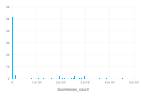

In [9]:
plot(model_data, x=:businesses_count, Geom.histogram)

In [10]:
model_data = @from b in clean_df_geo begin
	@group b by b.Source_Zipcode into g
	@let bcount = Float64(length(g))
    @where bcount > 10
	@orderby descending(bcount)
	@select { zipcode = Float64(get(key(g))), businesses_count = bcount }
	@collect DataFrame
end

,zipcode,businesses_count
,Float64,Float64
1,94110.0,4528.0
2,94103.0,3862.0
3,94109.0,3575.0
4,94118.0,2974.0
5,94107.0,2960.0
6,94122.0,2829.0
7,94102.0,2767.0
8,94117.0,2559.0
9,94114.0,2541.0


In [12]:
training_data = permutedims(convert(Array, model_data), [2, 1])

2×28 Array{Float64,2}:
 94110.0  94103.0  94109.0  94118.0  …  94158.0  94130.0  94129.0  94143.0
  4528.0   3862.0   3575.0   2974.0       145.0    142.0    141.0     14.0

In [13]:
result = kmeans(training_data, 3, init=:kmpp, display=:iter)

  Iters               objv        objv-change | affected 
-------------------------------------------------------------
      0       6.726516e+06
      1       4.730363e+06      -1.996153e+06 |        0
      2       4.730363e+06       0.000000e+00 |        0
K-means converged with 2 iterations (objv = 4.73036279655838e6)


KmeansResult{Float64}([94135.5 94114.8 94107.3; 552.875 2354.59 3988.33], [3, 3, 3, 2, 2, 2, 2, 2, 2, 2  …  2, 2, 1, 1, 1, 1, 1, 1, 1, 1], [2.91247e5, 15978.9, 1.70847e5, 383681.0, 3.66585e5, 225118.0, 1.70248e5, 41788.9, 34750.0, 26384.1  …  1.8121e5, 5.23581e5, 5.419e5, 2.59281e5, 87101.0, 52510.5, 1.66868e5, 1.68849e5, 1.69683e5, 2.90443e5], [8, 17, 3], [8.0, 17.0, 3.0], 4.73036279655838e6, 2, true)

In [14]:
result.assignments

28-element Array{Int64,1}:
 3
 3
 3
 2
 2
 2
 2
 2
 2
 2
 2
 2
 2
 ⋮
 2
 2
 2
 2
 1
 1
 1
 1
 1
 1
 1
 1

In [15]:
model_data[:cluster_id] = result.assignments

28-element Array{Int64,1}:
 3
 3
 3
 2
 2
 2
 2
 2
 2
 2
 2
 2
 2
 ⋮
 2
 2
 2
 2
 1
 1
 1
 1
 1
 1
 1
 1

In [16]:
model_data

,zipcode,businesses_count,cluster_id
,Float64,Float64,Int64
1,94110.0,4528.0,3
2,94103.0,3862.0,3
3,94109.0,3575.0,3
4,94118.0,2974.0,2
5,94107.0,2960.0,2
6,94122.0,2829.0,2
7,94102.0,2767.0,2
8,94117.0,2559.0,2
9,94114.0,2541.0,2


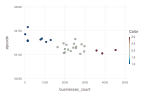

In [18]:
plot(model_data, y = :zipcode, x = :businesses_count, color = result.assignments, Geom.point, Scale.x_continuous(minvalue=0, maxvalue=5000), Scale.y_continuous(minvalue=94050, maxvalue=94200), Scale.x_continuous(format=:plain))

In [20]:
companies_in_top_areas = @from c in clean_df_geo begin
    @where in(c.Source_Zipcode, [94110, 94103, 94109])
    @select c
    @collect DataFrame
end

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description,lat,long
,String⍰,Int64⍰,String⍰,String⍰,Float64⍰,Float64⍰
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade,37.7877,-122.42
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services,37.7519,-122.418
3,Sunflower Restaurant,94103,7220-7229,Food Services,37.7649,-122.422
4,Bay Music & Entertainment Inc,94109,7100-7199,"Arts, Entertainment, and Recreation",37.7957,-122.423
5,Impark 0376,94109,4400-4599,Retail Trade,37.7891,-122.417
6,Geologica Inc,94103,5400-5499,"Professional, Scientific, and Technical Services",37.7875,-122.403
7,Impark 0315,94109,4400-4599,Retail Trade,37.7894,-122.422
8,Impark 0324,94103,4400-4599,Retail Trade,37.7867,-122.405
9,Impark 0370,94103,4400-4599,Retail Trade,37.7818,-122.405


In [22]:
plot(companies_in_top_areas, y = :long, x = :lat, Geom.point, Scale.x_continuous(minvalue=36, maxvalue=40), Scale.y_continuous(minvalue=-125, maxvalue=-120), color=:Source_Zipcode)

In [23]:
companies_in_top_areas = @from c in companies_in_top_areas begin
	@where c.lat != minimum(companies_in_top_areas[:lat])
	@select c
	@collect DataFrame
end

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description,lat,long
,String⍰,Int64⍰,String⍰,String⍰,Float64⍰,Float64⍰
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade,37.7877,-122.42
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services,37.7519,-122.418
3,Sunflower Restaurant,94103,7220-7229,Food Services,37.7649,-122.422
4,Bay Music & Entertainment Inc,94109,7100-7199,"Arts, Entertainment, and Recreation",37.7957,-122.423
5,Impark 0376,94109,4400-4599,Retail Trade,37.7891,-122.417
6,Geologica Inc,94103,5400-5499,"Professional, Scientific, and Technical Services",37.7875,-122.403
7,Impark 0315,94109,4400-4599,Retail Trade,37.7894,-122.422
8,Impark 0324,94103,4400-4599,Retail Trade,37.7867,-122.405
9,Impark 0370,94103,4400-4599,Retail Trade,37.7818,-122.405


In [24]:
plot(companies_in_top_areas, y = :long, x = :lat, Geom.point, Scale.x_continuous(minvalue=36, maxvalue=40), Scale.y_continuous(minvalue=-125, maxvalue=-120), color=:Source_Zipcode)

In [26]:
activities = @from c in companies_in_top_areas begin
	@group c by c.NAICS_Code_Description into g
	@orderby descending(length(g))
	@select { activity = key(g), number_of_companies = length(g) }
	@collect DataFrame
end

,activity,number_of_companies
,String⍰,Int64
1,Real Estate and Rental and Leasing Services,3198
2,"Professional, Scientific, and Technical Services",1596
3,Retail Trade,1467
4,Food Services,1154
5,"Arts, Entertainment, and Recreation",894
6,Private Education and Health Services,568
7,Accommodations,537
8,Construction,496
9,Multiple,343


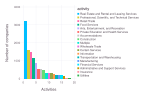

In [27]:
plot(activities, y=:number_of_companies, Geom.bar, color=:activity, Scale.y_continuous(format=:plain), Guide.XLabel("Activities"), Guide.YLabel("Number of companies"))

In [28]:
model_data = @from c in companies_in_top_areas begin
	@select { latitude = c.lat, longitude = c.long }
	@collect DataFrame
end

,latitude,longitude
,Float64⍰,Float64⍰
1,37.7877,-122.42
2,37.7519,-122.418
3,37.7649,-122.422
4,37.7957,-122.423
5,37.7891,-122.417
6,37.7875,-122.403
7,37.7894,-122.422
8,37.7867,-122.405
9,37.7818,-122.405


In [32]:
training_data = permutedims(convert(Array{Float64}, model_data), [2, 1])

2×11964 Array{Float64,2}:
   37.7877    37.7519    37.7649  …    37.7845    37.7865    37.7535
 -122.42    -122.418   -122.422      -122.418   -122.423   -122.424 

In [33]:
result = kmeans(training_data, 12, init=:kmpp, display=:iter)

  Iters               objv        objv-change | affected 
-------------------------------------------------------------
      0       5.010927e-01
      1       3.800674e-01      -1.210253e-01 |       11
      2       3.484529e-01      -3.161454e-02 |       11
      3       3.332623e-01      -1.519056e-02 |       11
      4       3.279047e-01      -5.357623e-03 |       11
      5       3.245505e-01      -3.354260e-03 |       10
      6       3.227955e-01      -1.754980e-03 |       10
      7       3.215479e-01      -1.247558e-03 |       11
      8       3.204897e-01      -1.058258e-03 |       11
      9       3.199249e-01      -5.647272e-04 |       10
     10       3.196079e-01      -3.170106e-04 |       10
     11       3.194759e-01      -1.319837e-04 |        9
     12       3.193538e-01      -1.221396e-04 |       10
     13       3.192582e-01      -9.562341e-05 |       10
     14       3.191949e-01      -6.324272e-05 |       10
     15       3.191565e-01      -3.840750e-05 |        

KmeansResult{Float64}([37.7671 37.7982 … 37.7546 37.788; -122.407 -122.421 … -122.416 -122.423], [12, 11, 5, 2, 6, 4, 12, 4, 4, 4  …  12, 11, 5, 12, 11, 11, 11, 6, 12, 11], [7.8739e-6, 1.00401e-5, 8.77611e-7, 1.08353e-5, 1.46712e-6, 3.11819e-5, 2.96158e-6, 1.94578e-5, 2.23087e-6, 2.91812e-5  …  2.7762e-5, 1.07693e-5, 2.41984e-5, 1.31162e-6, 3.58888e-5, 6.61359e-5, 1.74074e-5, 2.34509e-5, 2.52006e-6, 5.82154e-5], [1076, 1247, 569, 1180, 1711, 1191, 695, 1, 1188, 29, 1928, 1149], [1076.0, 1247.0, 569.0, 1180.0, 1716.0, 1191.0, 695.0, 1.0, 1188.0, 29.0, 1923.0, 1149.0], 0.3191144133161288, 21, true)

In [34]:
result.counts

12-element Array{Int64,1}:
 1076
 1247
  569
 1180
 1711
 1191
  695
    1
 1188
   29
 1928
 1149

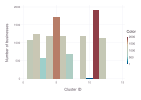

In [37]:
plot(result.counts, Geom.bar, y=result.counts, Guide.YLabel("Number of businesses"), Guide.XLabel("Cluster ID"), color=result.counts)

In [38]:
companies_in_top_areas[:cluster_id] = result.assignments

11964-element Array{Int64,1}:
 12
 11
  5
  2
  6
  4
 12
  4
  4
  4
  6
 12
  6
  ⋮
 12
  5
 12
 11
  5
 12
 11
 11
 11
  6
 12
 11

In [39]:
plot(companies_in_top_areas, color=:cluster_id, x=:lat, y=:long)

In [41]:
export_data = @from c in companies_in_top_areas begin
                  @select { Name = c.DBA_Name, Zip = c.Source_Zipcode,
                              Group = string("Cluster $(c.cluster_id)"),
                                Latitude = c.lat, Longitude = c.long, City = "San Francisco",
                                   State = "CA" }
                @collect DataFrame
end

,Name,Zip,Group,Latitude,Longitude,City,State
,String⍰,Int64⍰,String,Float64⍰,Float64⍰,String,String
1,Zaalouk Market & Deli Grocery,94109,Cluster 12,37.7877,-122.42,San Francisco,CA
2,1-11 Lilac St Apts,94110,Cluster 11,37.7519,-122.418,San Francisco,CA
3,Sunflower Restaurant,94103,Cluster 5,37.7649,-122.422,San Francisco,CA
4,Bay Music & Entertainment Inc,94109,Cluster 2,37.7957,-122.423,San Francisco,CA
5,Impark 0376,94109,Cluster 6,37.7891,-122.417,San Francisco,CA
6,Geologica Inc,94103,Cluster 4,37.7875,-122.403,San Francisco,CA
7,Impark 0315,94109,Cluster 12,37.7894,-122.422,San Francisco,CA
8,Impark 0324,94103,Cluster 4,37.7867,-122.405,San Francisco,CA
9,Impark 0370,94103,Cluster 4,37.7818,-122.405,San Francisco,CA


In [45]:
CSV.write("businesses.csv", head(export_data, 250))

"businesses.csv"